In [439]:
import numpy as np
import matplotlib
#matplotlib.use("TkAgg")
from matplotlib import pyplot as plt
from skimage import io,color
import scipy.sparse
import cv2 as cv2
from scipy import stats,misc
import pylab
from colour.models import XYZ_to_sRGB, sRGB_to_XYZ,XYZ_to_xyY,xyY_to_XYZ


# 1. HDR imaging (40 points)

## 1.1 Develop RAW images (5 points)
Use dcraw to convert the RAW .NEF images into linear 16-bit .TIFF images.
For this, 
<1> you should direct dcraw to do white balancing using the camera’s profile for white balancing, 
<2> do demosaicing using high-quality interpolation, 
<3> and use sRGB as the output color space. 
Read through dcraw’s documentation, and figure out what the correct set of flags are for this conversion. 
Make sure to report the flags you use in the report you submit with your solution.

dcraw -4  -T -w -a -o 1 -q 3 -f *.nef

## 1.2 Linearize rendered images (15 points).

## 1.3 Merge exposure stack into HDR image (10 points)

In [440]:
def get_samples(imgs_array, time_series,channel, num_points):
    '''Returns a matrix with intensity values (0-255) with many rows as sample points,
        and many columns as exposure times (num. of images)'''
    #Samples points
    #img_shape = imgs_array[imgs_array.keys()[0]].shape
    img_shape = imgs_array[:,:,:,0].shape
    num_points = int(num_points)
    sp_x = np.random.randint(0, img_shape[0]-1, (num_points, 1))
    sp_y = np.random.randint(0, img_shape[1]-1, (num_points, 1))
    sp = np.concatenate((sp_x, sp_y), axis=1)

    n = len(sp)
    p = len(time_series)
    Z = np.zeros((n, p))
    B = np.zeros((p, 1))
    #print(imgs_array.shape)
    for i in range(0, n):
        j = 0
        for key in range(len((time_series))):
            #img = imgs_array[:,:,:,key][:, :, channel]
            img = imgs_array[:,:,channel,key]
            row = sp[i, 0]
            col = sp[i, 1]
            Z[i, j] = img[row, col]
            B[j, 0] = time_series[key]
            j += 1

    return Z, B     

In [441]:
def fit_response(Z, B, l, w):
    '''Finds all values for the discrete log of exposure function, as well as the Radiance
        values (E) for each point'''

    #max num of intensity levels
    num_gray_levels = 256
    n = Z.shape[0]
    p = Z.shape[1]
    num_rows = n*p + num_gray_levels -2 + 1
    num_cols = num_gray_levels + n


    A = np.zeros((num_rows, num_cols),dtype=float)
    b = np.zeros((num_rows, 1),dtype=float)
    #Fill the coeficients in matrix A, according to the equation: G(z) = ln(E) + ln(dt)
    #multiplied by a weighting function (w)
    k = 0
    for j in range(0, p):
        for i in range(0, n):
            z_value = int(Z[i, j])
            #print("z_value:",z_value)
            w_value = w(z_value)
            #print("w_walue:",w_value)
            A[k, z_value] = w_value
            A[k, num_gray_levels + i] = -w_value
            b[k, 0] = w_value * np.log(B[j])
            k += 1

    #Setting the middle value of the G function as '0'
    A[k, 128] = 1
    k += 1

    #Add the smoothness constraints
    for i in range(1, num_gray_levels-1):
        w_value = w(i)
        A[k, i-1] = l*w_value
        A[k, i] = -2*l*w_value
        A[k, i+1] = l*w_value
        k += 1

    #Solve the equation system
    
    inv_A = np.linalg.pinv(A)
    m = np.dot(inv_A,b)
    
    #print("fit_responze max:",np.max(m[0:256]))
    #print("fit_responze min:",np.min(m[0:256]))

    return m[0:256], m[256:]

In [442]:
def create_linearized_image(imgs, time_series, Gs, w):
    '''Using the log. exposure function (G) create a radiance map
        for every channel in the image'''

    #returns a function to calculate the Radiance of a associated
    #to an intensity value
    def map_z_values(exposure_time,channel):
        return np.vectorize(lambda z: Gs[channel][z] - np.log(exposure_time))


    #vector form of weighting function
    get_w_values = np.vectorize(w)

    #Reduce noise by weighting the E values
    #img_shape = imgs[imgs.keys()[0]].shape
    img_shape = imgs[:,:,0,0].shape

    radiance = np.zeros_like(imgs).astype(np.float64)

    for dt in range(len(time_series)):
        #print('Processing image with dt = ', time_series[dt])
        for channel in [0,1,2]:

            r = Gs[channel][imgs[:,:,channel,dt]] - np.log(time_series[dt])

            radiance[:,:,channel,dt] = r.reshape(img_shape)
    
    return radiance

In [443]:
def read_exposure_stack(image_names,downsampling=4,rendered='no'):
    '''
    [Description]
    
    [In]
        image_names:
        
    [Out]
         hdr image stack
    '''
    for i in range(len(image_names)):
        print("reading "+image_names[i])
        if rendered == 'yes':
            raw = np.asarray(misc.imread(image_names[i])).astype(np.uint8)
        else:
            raw = np.asarray(io.imread(raw_image_names[i])).astype(np.float64)  

        #DEBUG: REDUCE THE COMPUTATION!!!
        raw = raw[::downsampling,::downsampling,:]    #1/4 of original size
            
        if i == 0:
            if rendered == 'yes':
                raw_images = np.zeros((raw.shape[0],raw.shape[1],3,len(image_names))).astype(np.uint8) #3 for 'r','g','b'
            else:
                raw_images = np.zeros((raw.shape[0],raw.shape[1],3,len(image_names))).astype(np.float64) #3 for 'r','g','b'
                
            #weights = np.ones_like(raw_images)

        raw_images[:,:,:,i] = raw[:,:,:]
    
    #return raw_images,weights
    return raw_images


def do_linearization(raw_images,weight_scheme='default',scale=1.0,zmin=0.01,zmax=0.99):
    '''
    [Description]
    
    [In]
        raw_images: Image stack
       
    [Out]
        Linear hdr stack, Response func.
    '''
    #Fitting the curve
    Zmin = 0.0      #np.amin(Z)
    Zmax = 255.0    #np.amax(Z)
        
    #print("Process do_linearization:",weight_scheme,", scale:",scale)
        
    #Weight

    #'''
    if weight_scheme == 'tent':
        w_hat = lambda z: np.max([z/scale,1.0-z/scale])  if (z/scale <= zmax and z/scale>= zmin) else 0
    elif weight_scheme == 'gaussian':
        w_hat = lambda z: np.exp((z/scale - 0.5)**2 *(-4)/(0.5**2)) if (z/scale <= zmax and z/scale>= zmin) else 0 
    elif weight_scheme == 'normal':
        w_hat = lambda z: 1 if (z/scale <= zmax and z/scale>= zmin) else 0 
    else:     
        w_hat = lambda z: z - Zmin + 1 if z <= (Zmin + Zmax)/2 else Zmax - z + 1 
    #'''

    #sampling
    Gs = []
    #num_samples = 1500.0 / len(time_series) /4 # /4 for saving computation
    num_samples = 1500.0 / len(time_series) 

    l = 550 
        
    for channel in [0,1,2]:
        Z, B = get_samples(raw_images, time_series,channel, num_samples)
        n, p = Z.shape
        
        print('Fitting log exposure curve...')
        G, E = fit_response(Z, B, l, w_hat)

        Gs.append(G)

    #creating radiance map for the channel
    print('Creating radiance map (could take a while...)')
    
    radiance = create_linearized_image(raw_images,time_series, Gs, w_hat)
        
    #raw_images = np.exp(raw_images)

    
    return radiance,Gs

def merge_exposure_stack(raw_images,time_series,radiance=None,scale=4095.0,domain='linear',weight_scheme='uniform',zmin=0.01,zmax=0.99,downsampling=4,rendered='no'):
    '''
    [Description]
    
    [In]
        raw_images: Image stack
        weights: 
        time_series:
        scale: 4095,255
        domain: 'linear','log'
        weight_scheme: 'uniform', 'tent', 'gaussian'
        zmin, zmax: thresh for weight scheme
        downsampling:1,2,3,4..., for memory & time saving reason, downsampling the pic
        rendered: indicator if the exposure stack are rendered(jpg etc.)
    [Out]
        Merged hdr
    '''
            
    #print("Min/Max value in pic:{0}/{1}".format(np.min(raw),np.max(raw)))
            
    #Scaling
    #print("Scaling...")
    raw_images_scaled = raw_images/scale
          
    weights = np.ones_like(raw_images)

    if weight_scheme == 'tent':
        weights = np.maximum(raw_images_scaled,1-raw_images_scaled)
   
        weights [raw_images_scaled > zmax ] = 0.0
        weights [raw_images_scaled < zmin] = 0.0
    elif weight_scheme == 'gaussian':
        weights = np.exp(( raw_images_scaled - 0.5 ) ** 2 * ( -4 )/ 0.5 ** 2 )
        weights [raw_images_scaled > zmax ] = 0.0
        weights [raw_images_scaled < zmin] = 0.0
    elif weight_scheme == 'normal':     #Actually do nothing for normal scheme
        weights[weights > 0] = 1.0
        weights [raw_images_scaled > zmax ] = 0.0
        weights [raw_images_scaled < zmin] = 0.0
    elif weight_scheme == 'origin':
        Zmin = 0.0      #np.amin(Z)
        Zmax = 255.0    #np.amax(Z)
        Zmid = (Zmin + Zmax)/2
        w0 = raw_images - Zmin + 1
        w1 = Zmax - raw_images + 1
        weights = [ raw_images <= Zmid ] * w0 + [ raw_images > Zmid ] * w1
        weights = np.squeeze(weights)
    
    #Clipping
    #print("Clipping...")
    print("Min/Max value in raw_images:{0}/{1}".format(np.min(raw_images),np.max(raw_images)))

    
    #Merging
    print("Merging...")
    epsilon = 1e-5
    
    image_lin = np.zeros(raw_images.shape,dtype=np.float)
    
    if rendered == 'yes':
        image_lin = np.exp(radiance)
    else:
        image_lin = raw_images
        
    if domain == 'log':
        for i in range(len(time_series)):
            image_lin[:,:,:,i] = np.log(image_lin[:,:,:,i]+epsilon) - np.log(time_series[i])
        
        output = np.multiply(image_lin,weights)
    else:  #linear
        output = np.multiply(image_lin,weights)
        
        for i in range(len(time_series)):
            output[:,:,:,i] = output[:,:,:,i]/time_series[i]

    #print("Min/Max value in weights:{0}/{1}".format(np.min(weights),np.max(weights)))

    sum_v = np.sum(output,3) 
    sum_w = np.sum(weights,3)
    print("min of sum of weights:",np.min(sum_w))
    sum_w[sum_w == 0.0] = 1.0
    
    sum_w = sum_w
    result = sum_v/sum_w
    
    result[np.isnan(result)] = 0.0
    result[np.isneginf(result)] = 0.0
    result[np.isposinf(result)] = 1.0
    
    if domain == 'log':
        result = np.exp(result)
        
    #print("sum_v shape:",sum_v.shape)
    #print("sum_w shape:",sum_w.shape)
    
    #return output[:,:,:,0] * scale

    return result

In [444]:
def save_hdr(image,name):
    # Assumes you have a np.array((height,width,3), dtype=float) as your HDR image
    print("Saving ..., ",name)
    f = open(name, "wb")
    f.write(b"#?RADIANCE\n# Made with Python & Numpy\nFORMAT=32-bit_rle_rgbe\n\n")
    meta = "-Y {0} +X {1}\n".format(image.shape[0], image.shape[1])
    f.write(str.encode(meta))

    brightest = np.maximum(np.maximum(image[...,0], image[...,1]), image[...,2])
    mantissa = np.zeros_like(brightest)
    exponent = np.zeros_like(brightest)
    np.frexp(brightest, mantissa, exponent)
    scaled_mantissa = mantissa * 256.0 / brightest
    rgbe = np.zeros((image.shape[0], image.shape[1], 4), dtype=np.uint8)
    rgbe[...,0:3] = np.around(image[...,0:3] * scaled_mantissa[...,None])
    rgbe[...,3] = np.around(exponent + 128)

    rgbe.flatten().tofile(f)
    f.close()

## 1.4 Evaluation (10 points)

In [445]:
def evaluate(hdr,downsampling=4):
    '''
    [Description]
    
    [In]
        hdr: rediance image
        downsampling:1,2,3,4..., for memory & time saving reason, downsampling the pic

    [Out]
    ''' 

    patch_pos = np.array([         #Downsampling by factor 4
                    (160,945,20,20),  #(y,x,h,w) 2960
                    (200,945,20,20),  #(y,x,h,w)
                    (240,945,20,20),  #(y,x,h,w)
                    (280,945,20,20),  #(y,x,h,w)
                    (320,945,20,20),  #(y,x,h,w)
                    (360,945,20,20)  #(y,x,h,w)
                ])
    #print(patch_pos)
    
    #Corlor space

    xyz = np.array(sRGB_to_XYZ(hdr))

    #from skimage import color
    #xyz = color.rgb2xyz(hdr)


    #Linear Regression on Y channel
    R = np.array([0,0.0625,0.125,0.25,0.5,1.0]) #Reflectance
    R = np.array(range(6))
    x = []  #mean pixel intensity of Y
    epsilon = 0.00000001
    #epsilon = 0

    for i in range(len(patch_pos)):
        y0 = patch_pos[i][0]
        y1 = patch_pos[i][0] + patch_pos[i][2]
        x0 = patch_pos[i][1]
        x1 = patch_pos[i][1] + patch_pos[i][3]
        mean_x = np.log(np.mean(xyz[y0:y1,x0:x1,1])+epsilon)  # 1 means Y channel?

        x.append(mean_x)
        
    X = np.array(x)
    
    slope, intercept, r_value, p_value, slope_std_error = stats.linregress(R,X)
    predict_y = intercept + slope * R
    pred_error = X - predict_y
    #degrees_of_freedom = len(X) - 2
    #residual_std_error = np.sqrt(np.sum(pred_error**2) / degrees_of_freedom)
    least_squares_error = np.sqrt(np.sum(pred_error**2))
    #print("LS Error:",least_squares_error)

    return X,R,predict_y,least_squares_error
    

# 2. Tonemapping (35 points)

## 2.1 Photographic tonemapping (10 points)

In [446]:
def RGB2xyY(RGBImage):
    '''
    [Description]
    
    [In]
        XYZ: image in XYZ color space
    [Out]
        image in xyY color space
    '''
    return XYZ_to_xyY(sRGB_to_XYZ(RGBImage))


In [447]:
def xyY2RGB(xyYImage):
    '''
    [Description]
    
    [In]
        XYZ: image in XYZ color space
    [Out]
        image in xyY color space
    '''
    return XYZ_to_sRGB(xyY_to_XYZ(xyYImage))

In [448]:
def photographic_tonemapping(hdr,mode='RGB'):
    '''
    [Description]
    
    [In]
        hdr: rediance image
    [Out]
        tonemapped image
    ''' 
    K = 0.15
    B = 0.95
    epsilon = 0.00001
    
    N = hdr.shape[0] * hdr.shape[1]
    
    I_hat_ij_hdr = np.zeros_like(hdr)
    I_ij_tm = np.zeros_like(hdr)
    
    if mode == 'Y':
        xyY = RGB2xyY(hdr)
        I_ij_tm[:,:,0] = xyY[:,:,0]
        I_ij_tm[:,:,1] = xyY[:,:,1]
        I_m_hdr = np.exp(np.sum(np.log(xyY[:,:,2] + epsilon))/N)
        I_hat_ij_hdr[:,:,2] = K * xyY[:,:,2]/I_m_hdr
        I_hat_white = B * np.max(I_hat_ij_hdr[:,:,2])
        I_ij_tm[:,:,2] = I_hat_ij_hdr[:,:,2] * (1 + I_hat_ij_hdr[:,:,2]/(I_hat_white**2))/(1+I_hat_ij_hdr[:,:,2])
        
        I_ij_tm[np.isnan(I_ij_tm)] = 0

        return (xyY2RGB(I_ij_tm))
    else:   #RGB
        for i in range(3):
            I_m_hdr = np.exp(np.sum(np.log(hdr[:,:,i] + epsilon))/N)
            I_hat_ij_hdr[:,:,i] = K * hdr[:,:,i]/I_m_hdr
            I_hat_white = B * np.max(I_hat_ij_hdr[:,:,i])
            I_ij_tm[:,:,i] = I_hat_ij_hdr[:,:,i] * (1 + I_hat_ij_hdr[:,:,i]/(I_hat_white**2))/(1+I_hat_ij_hdr[:,:,i])
            
        I_ij_tm[np.isnan(I_ij_tm)] = 0

        return I_ij_tm 

## 2.2 Tonemapping using bilateral filtering (25 points)

In [449]:
def bf_tonemapping(hdr,mode='RGB'):
    '''
    [Description]
    
    [In]
        hdr: rediance image
    [Out]
        tonemapped image
    ''' 
    S = 2
    S = 0.4
    epsilon = 1e-5
    
    if mode == 'Y':
        xyY = RGB2xyY(hdr).astype(np.float32)
        
        I_ij_tm = np.zeros_like(hdr)
        I_ij_tm[:,:,0] = xyY[:,:,0]
        I_ij_tm[:,:,1] = xyY[:,:,1]
        
        L_ij = np.log(xyY[:,:,2] + epsilon)
        #TBD
        L_ij[np.isnan(L_ij)] = 0
    
        #B_ij = cv2.bilateralFilter(L_ij,15,10,10)
        B_ij = cv2.bilateralFilter(L_ij,5,21,21)

        D_ij = L_ij - B_ij
        B_ij_max = np.max(B_ij)
    
        B_ij_2 = S * (B_ij - B_ij_max)
        I_ij_tm[:,:,2] = np.exp(B_ij_2 + D_ij)
        
        I_ij_tm[np.isnan(I_ij_tm)] = 0
        
        return (xyY2RGB(I_ij_tm))
    else:   #RGB
        L_ij = np.log(hdr.astype(np.float32) + epsilon)
        #TBD
        L_ij[np.isnan(L_ij)] = 0
                
        I_ij_tm = np.zeros_like(hdr)
        for i in range(3):
            B_ij = cv2.bilateralFilter(L_ij[:,:,i],15,10,10)
            D_ij = L_ij[:,:,i] - B_ij
            B_ij_max = np.max(B_ij)
    
            B_ij_2 = S * (B_ij - B_ij_max)
            I_ij_tm[:,:,i] = np.exp(B_ij_2 + D_ij)
      
        I_ij_tm[np.isnan(I_ij_tm)] = 0

        return I_ij_tm 

## 2.3 Gamma correction

In [450]:
def gamma_correction(hdr_image):
    gamma_image = np.zeros(hdr_image.shape)     
    mask1 = np.zeros(hdr_image.shape)
    mask2 = np.zeros(hdr_image.shape)
    mask1[hdr_image <= 0.00313308] = 1.0 
    mask2[hdr_image > 0.00313308] = 1.0 
    gamma_image = mask1 * 12.92 * hdr_image + mask2 * (np.power(hdr_image,1/2.4) *(1+0.055)) - 0.055

    return gamma_image

# 3. Create and tonemap your own HDR photo (25 points)

# 0. Main entry
## 0.1 Merge

In [451]:

   
raw_image_names = ['../data/exposure_stack/exposure1.tiff','../data/exposure_stack/exposure2.tiff',
                   '../data/exposure_stack/exposure3.tiff','../data/exposure_stack/exposure4.tiff',
                   '../data/exposure_stack/exposure5.tiff','../data/exposure_stack/exposure6.tiff',
                   '../data/exposure_stack/exposure7.tiff','../data/exposure_stack/exposure8.tiff',
                   '../data/exposure_stack/exposure9.tiff','../data/exposure_stack/exposure10.tiff',
                   '../data/exposure_stack/exposure11.tiff','../data/exposure_stack/exposure12.tiff',
                   '../data/exposure_stack/exposure13.tiff','../data/exposure_stack/exposure14.tiff',
                   '../data/exposure_stack/exposure15.tiff','../data/exposure_stack/exposure16.tiff']
scale1 = 65535.0 #16bit 


rendered_image_names = ['../data/exposure_stack/exposure1.jpg','../data/exposure_stack/exposure2.jpg',
                   '../data/exposure_stack/exposure3.jpg','../data/exposure_stack/exposure4.jpg',
                   '../data/exposure_stack/exposure5.jpg','../data/exposure_stack/exposure6.jpg',
                   '../data/exposure_stack/exposure7.jpg','../data/exposure_stack/exposure8.jpg',
                   '../data/exposure_stack/exposure9.jpg','../data/exposure_stack/exposure10.jpg',
                   '../data/exposure_stack/exposure11.jpg','../data/exposure_stack/exposure12.jpg',
                   '../data/exposure_stack/exposure13.jpg','../data/exposure_stack/exposure14.jpg',
                   '../data/exposure_stack/exposure15.jpg','../data/exposure_stack/exposure16.jpg']
scale2 = 255.0 #8bit 


time_series = []
    
for i in range(len(raw_image_names)):
    v = 2 ** i
    time_series.append(v/2048.0)

    
'''

raw_image_names = ['../data/hyatt/e1.jpg',
                   '../data/hyatt/e2.jpg',
                   '../data/hyatt/e3.jpg',
                   '../data/hyatt/e4.jpg',
                   ]
time_series = [0.033333,0.25,2.5,15.0]    
'''
    
weight_schemes = ['normal','tent','gaussian']
domains = ['linear','log']
#weight_schemes = ['normal']
#domains = ['linear']
    
#------------PARAS TOBE TUNED------------------
downsampling = 4

#'''
hdr_set = []
name_set = []

hdr_stack_raw = read_exposure_stack(raw_image_names,downsampling = downsampling,rendered='no')

for scheme in weight_schemes:
    for domain in domains:
        print("Processing hdr merging with weight scheme:%s, domain:%s"%(scheme,domain))
        hdr = merge_exposure_stack(hdr_stack_raw.copy(),time_series,scale=scale1,domain=domain,weight_scheme=scheme,downsampling=downsampling)

        hdr_set.append(hdr)
        name_set.append("raw_"+scheme+"_"+domain+".hdr")
            
        print(hdr.shape)
    
#print("Len of hdr set:%d",len(hdr_set))
#'''    


reading ../data/exposure_stack/exposure1.tiff
reading ../data/exposure_stack/exposure2.tiff
reading ../data/exposure_stack/exposure3.tiff
reading ../data/exposure_stack/exposure4.tiff
reading ../data/exposure_stack/exposure5.tiff
reading ../data/exposure_stack/exposure6.tiff
reading ../data/exposure_stack/exposure7.tiff
reading ../data/exposure_stack/exposure8.tiff
reading ../data/exposure_stack/exposure9.tiff
reading ../data/exposure_stack/exposure10.tiff
reading ../data/exposure_stack/exposure11.tiff
reading ../data/exposure_stack/exposure12.tiff
reading ../data/exposure_stack/exposure13.tiff
reading ../data/exposure_stack/exposure14.tiff
reading ../data/exposure_stack/exposure15.tiff
reading ../data/exposure_stack/exposure16.tiff
Processing hdr merging with weight scheme:normal, domain:linear
Min/Max value in raw_images:0.0/65535.0
Merging...
min of sum of weights: 0.0
(1004, 1504, 3)
Processing hdr merging with weight scheme:normal, domain:log
Min/Max value in raw_images:0.0/65535.

## Merging rendered image stack

In [452]:
#'''
weight_schemes = ['origin','normal','tent','gaussian']
#domains = ['linear','log']
#weight_schemes = ['origin','normal']
#domains = ['linear']
#hdr_set = []
#name_set = []
#Process rendered image stack(jpg)
hdr_stack_rendered = read_exposure_stack(rendered_image_names,downsampling = downsampling,rendered='yes')

response_func_set = []

for scheme in weight_schemes:
    radiance,Gs = do_linearization(hdr_stack_rendered,scale=scale2,weight_scheme=scheme)
    
    response_func_set.append(Gs)
    
    for domain in domains:
        print("Processing hdr merging with weight scheme:%s, domain:%s"%(scheme,domain))

        hdr = merge_exposure_stack(hdr_stack_rendered.copy(),time_series,radiance=radiance.copy(),scale=scale2,domain=domain,weight_scheme=scheme,downsampling=downsampling,rendered='yes')

        hdr_set.append(hdr)
        name_set.append("rendered_"+scheme+"_"+domain+".hdr")
            
        print(hdr.shape)
    
#print("Len of hdr set:%d",len(hdr_set))
#'''

reading ../data/exposure_stack/exposure1.jpg
reading ../data/exposure_stack/exposure2.jpg
reading ../data/exposure_stack/exposure3.jpg
reading ../data/exposure_stack/exposure4.jpg
reading ../data/exposure_stack/exposure5.jpg
reading ../data/exposure_stack/exposure6.jpg
reading ../data/exposure_stack/exposure7.jpg
reading ../data/exposure_stack/exposure8.jpg
reading ../data/exposure_stack/exposure9.jpg
reading ../data/exposure_stack/exposure10.jpg
reading ../data/exposure_stack/exposure11.jpg
reading ../data/exposure_stack/exposure12.jpg
reading ../data/exposure_stack/exposure13.jpg
reading ../data/exposure_stack/exposure14.jpg
reading ../data/exposure_stack/exposure15.jpg
reading ../data/exposure_stack/exposure16.jpg
Fitting log exposure curve...
Fitting log exposure curve...
Fitting log exposure curve...
Creating radiance map (could take a while...)
Processing hdr merging with weight scheme:origin, domain:linear
Min/Max value in raw_images:0/255
Merging...
min of sum of weights: 51.0


## Draw response curve 

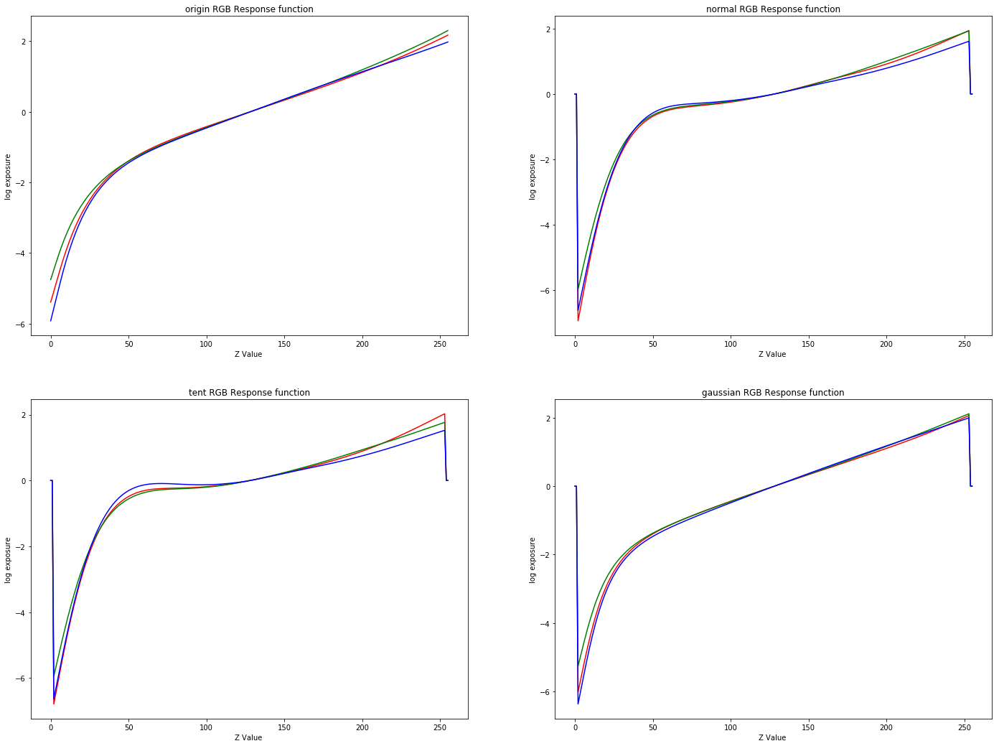

In [453]:
plt.figure(figsize=(24,18))

for i,scheme in enumerate(weight_schemes):
    px = plt.subplot( (len(response_func_set)+1)/2 ,2,i+1)
               
    Gs = response_func_set[i]
    
    plt.plot(np.arange(256),Gs[0],'r')
    plt.plot(np.arange(256),Gs[1],'g')
    plt.plot(np.arange(256),Gs[2],'b')

    plt.title( scheme +' RGB Response function')
    plt.xlabel('Z Value ')
    plt.ylabel('log exposure')
    plt.savefig( scheme+'_response_curve.png')

## 0.2 Plot & Save HDR

Saving ...,  raw_normal_linear.hdr


/Users/jasonjmac/virtualenv/python3env/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in true_divide
  del sys.path[0]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving ...,  raw_normal_log.hdr


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving ...,  raw_tent_linear.hdr


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving ...,  raw_tent_log.hdr
Saving ...,  raw_gaussian_linear.hdr


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving ...,  raw_gaussian_log.hdr
Saving ...,  rendered_origin_linear.hdr


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving ...,  rendered_origin_log.hdr
Saving ...,  rendered_normal_linear.hdr


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving ...,  rendered_normal_log.hdr


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving ...,  rendered_tent_linear.hdr


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving ...,  rendered_tent_log.hdr


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving ...,  rendered_gaussian_linear.hdr
Saving ...,  rendered_gaussian_log.hdr


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


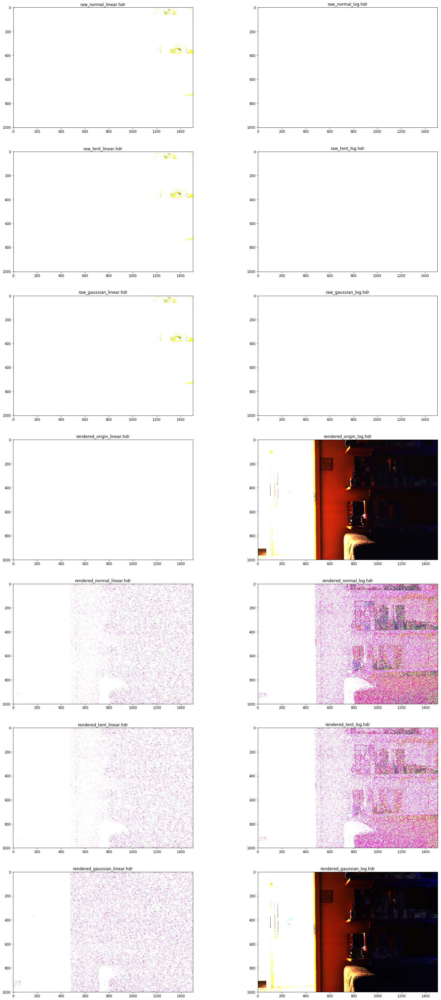

In [454]:
rows = (len(hdr_set) + 1)/2 
row_index = 0
    
plt.figure(figsize=(24,54))

epsilon = 1e-5
#Plot & Save HDR
for i in range(len(hdr_set)):
    
    save_hdr(hdr_set[i],name_set[i])
    px = plt.subplot( rows ,2,i+1)
    px.imshow(hdr_set[i])

    px.set_title(name_set[i])
    #print("min:%f,max:%f",np.min(hdr_set[i]),np.max(hdr_set[i]))


## 0.3 Evaluate HDR

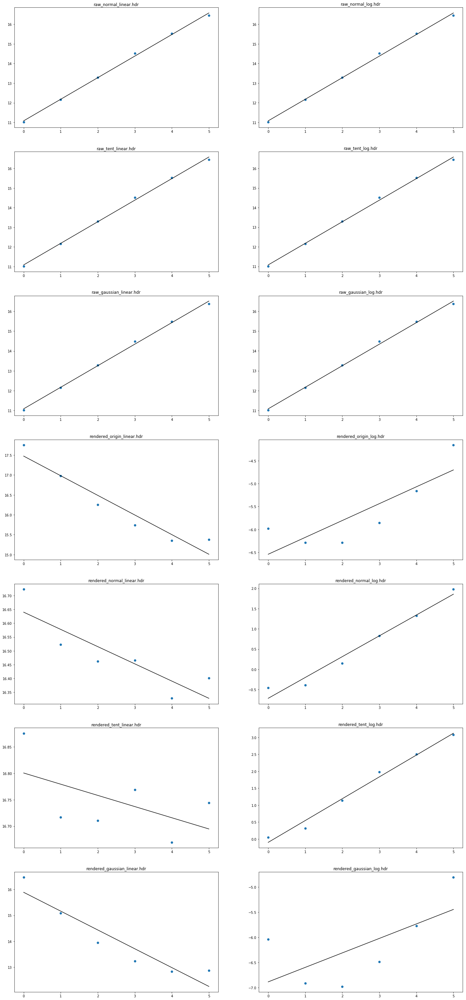

In [455]:
#Evaluate
plt.figure(figsize=(24,54))
for i in range(len(hdr_set)):
    X,R,predict_y,lse = evaluate(hdr_set[i],downsampling=downsampling)

    px = plt.subplot( rows ,2,i+1,label=name_set[i])
    #px.plot(X, R, 'o')
    #px.plot(X, predict_y, 'k-')
    px.plot(R, X, 'o')
    px.plot(R, predict_y, 'k-')
    #px.text(0.1,0.8,lse,color='red', fontsize=15)
    px.set_title(name_set[i])


## 0.4 Tone Mapping
### 0.4.1 Photographic Tonemapping on RGB

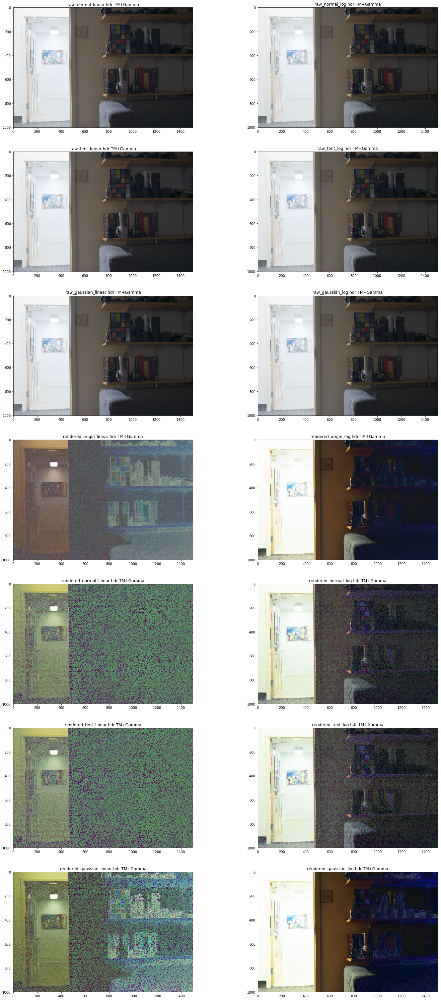

In [466]:
#Tone mapping
plt.figure(figsize=(24,54))
for i in range(len(hdr_set)):
    hdr_tm = photographic_tonemapping(hdr_set[i])
    hdr_tm_gamma = gamma_correction(hdr_tm)
    #print("Min/Max value in TM pic:{0}/{1}".format(np.min(hdr_tm),np.max(hdr_tm)))
    #print("Min/Max value in Gamma pic:{0}/{1}".format(np.min(hdr_tm_gamma),np.max(hdr_tm_gamma)))

    hdr_tm = hdr_tm.clip(0.0,1.0)
    hdr_tm_gamma = hdr_tm_gamma.clip(0.0,1.0)

    #px1 = plt.subplot( rows ,2,i+1,label=name_set[i])
    #px1.imshow(hdr_tm)
    #px1.set_title(name_set[i]+" origin")

    px2 = plt.subplot( rows ,2,i+1,label=name_set[i]+" TMGamma")
    px2.imshow(hdr_tm_gamma)
    px2.set_title(name_set[i]+" TM+Gamma")


### 0.4.2 Photographic Tonemapping on Y

/Users/jasonjmac/virtualenv/python3env/lib/python3.6/site-packages/colour/models/cie_xyy.py:97: RuntimeWarning: invalid value encountered in true_divide
  tstack((X / (X + Y + Z), Y / (X + Y + Z), Y)))
/Users/jasonjmac/virtualenv/python3env/lib/python3.6/site-packages/colour/models/rgb/transfer_functions/srgb.py:78: RuntimeWarning: invalid value encountered in power
  np.where(L <= 0.0031308, L * 12.92, 1.055 * (L ** (1 / 2.4)) - 0.055))
/Users/jasonjmac/virtualenv/python3env/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in power
  import sys


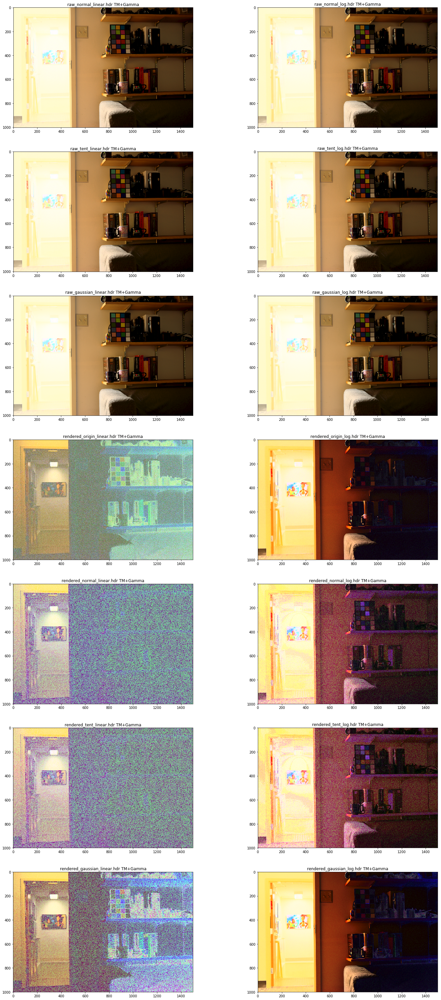

In [467]:
plt.figure(figsize=(24,54))
for i in range(len(hdr_set)):
    hdr_tm = photographic_tonemapping(hdr_set[i],mode='Y')

    hdr_tm_gamma = gamma_correction(hdr_tm)

    hdr_tm = hdr_tm.clip(0.0,1.0)
    hdr_tm_gamma = hdr_tm_gamma.clip(0.0,1.0)

    #px1 = plt.subplot( rows ,2,i+1,label=name_set[i])
    #px1.imshow(hdr_tm)
    #px1.set_title(name_set[i]+" origin")

    px2 = plt.subplot( rows ,2,i+1,label=name_set[i]+" TMGamma")
    px2.imshow(hdr_tm_gamma)
    px2.set_title(name_set[i]+" TM+Gamma")



## 0.4.3 Bilateral Filtering Tonemapping on RGB

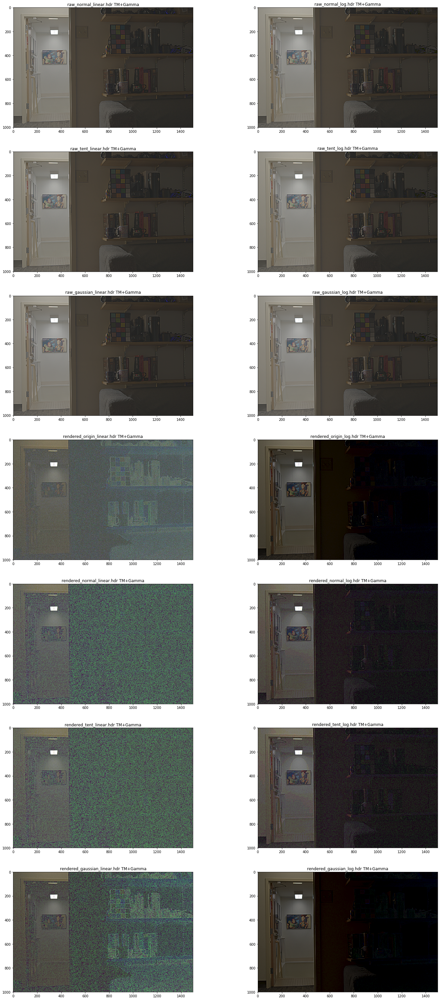

In [461]:
plt.figure(figsize=(24,54))
for i in range(len(hdr_set)):
    hdr_tm = bf_tonemapping(hdr_set[i])
    hdr_tm_gamma = gamma_correction(hdr_tm)

    hdr_tm = hdr_tm.clip(0.0,1.0)
    hdr_tm_gamma = hdr_tm_gamma.clip(0.0,1.0)

    #px1 = plt.subplot( rows ,2,i+1,label=name_set[i])
    #px1.imshow(hdr_tm)
    #px1.set_title(name_set[i]+" origin")

    px2 = plt.subplot( rows ,2,i+1,label=name_set[i]+" TMGamma")
    px2.imshow(hdr_tm_gamma)
    px2.set_title(name_set[i]+" TM+Gamma")


## 0.4.4 Bilateral Filtering Tonemapping on Y

/Users/jasonjmac/virtualenv/python3env/lib/python3.6/site-packages/colour/models/cie_xyy.py:97: RuntimeWarning: invalid value encountered in true_divide
  tstack((X / (X + Y + Z), Y / (X + Y + Z), Y)))
/Users/jasonjmac/virtualenv/python3env/lib/python3.6/site-packages/colour/models/rgb/transfer_functions/srgb.py:78: RuntimeWarning: invalid value encountered in power
  np.where(L <= 0.0031308, L * 12.92, 1.055 * (L ** (1 / 2.4)) - 0.055))
/Users/jasonjmac/virtualenv/python3env/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in power
  import sys


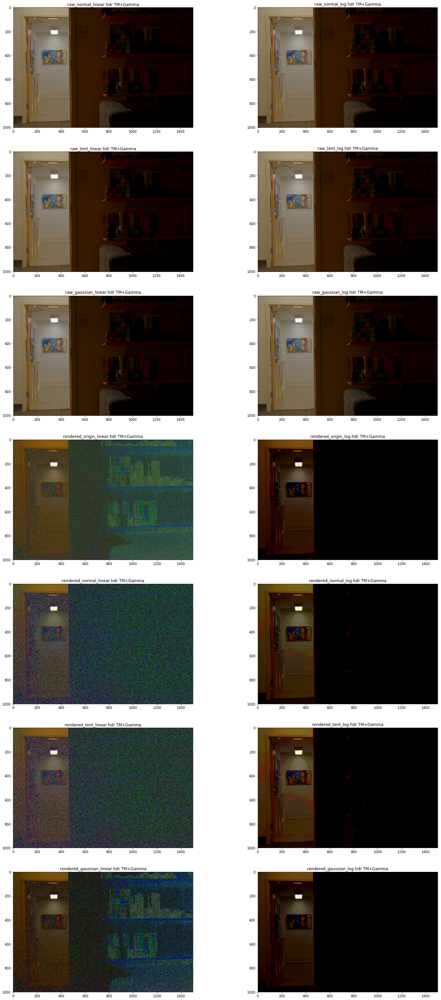

In [462]:
plt.figure(figsize=(24,54))
for i in range(len(hdr_set)):
    hdr_tm = bf_tonemapping(hdr_set[i],mode='Y')
    hdr_tm_gamma = gamma_correction(hdr_tm)
    
    hdr_tm = hdr_tm.clip(0.0,1.0)
    hdr_tm_gamma = hdr_tm_gamma.clip(0.0,1.0)

    #px1 = plt.subplot( rows ,2,i+1,label=name_set[i])
    #px1.imshow(hdr_tm)
    #px1.set_title(name_set[i]+" origin")

    px2 = plt.subplot( rows ,2,i+1,label=name_set[i]+" TMGamma")
    px2.imshow(hdr_tm_gamma)
    px2.set_title(name_set[i]+" TM+Gamma")